In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [ ]:
DATA_DIR = '../input/gandataset/'

In [ ]:
import os
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torch
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
from torchvision.utils import save_image
from torchvision.utils import make_grid
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import LeaveOneOut, cross_val_score
from sklearn.manifold import TSNE  # для снижения размерности с помощью t-SNE
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

from pathlib import Path

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.set(style='darkgrid', font_scale=1.2)

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
device

device(type='cuda')

In [ ]:
def get_folder_size(folder):
    return ByteSize(sum(file.stat().st_size for file in Path(folder).rglob('*')))

class ByteSize(int):
    _KB = 1024
    _suffixes = 'B', 'KB', 'MB', 'GB', 'PB'

    def __new__(cls, *args, **kwargs):
        return super().__new__(cls, *args, **kwargs)

    def __init__(self, *args, **kwargs):
        self.bytes = self.B = int(self)
        self.kilobytes = self.KB = self / self._KB**1
        self.megabytes = self.MB = self / self._KB**2
        self.gigabytes = self.GB = self / self._KB**3
        self.petabytes = self.PB = self / self._KB**4
        *suffixes, last = self._suffixes
        suffix = next((
            suffix
            for suffix in suffixes
            if 1 < getattr(self, suffix) < self._KB
        ), last)
        self.readable = suffix, getattr(self, suffix)

        super().__init__()

    def __str__(self):
        return self.__format__('.2f')

    def __repr__(self):
        return '{}({})'.format(self.__class__.__name__, super().__repr__())

    def __format__(self, format_spec):
        suffix, val = self.readable
        return '{val:{fmt}} {suf}'.format(val=val, fmt=format_spec, suf=suffix)

In [ ]:
# проверим размер папки с изображениями
size = get_folder_size(DATA_DIR)
print(size)

3.99 GB


In [ ]:
# проверим кол-во изображений
DR = '../input/gandataset/faces_dataset_small/'
print (len([name for name in os.listdir(DR) if os.path.isfile(os.path.join(DR, name))]))


3143


**Часть 1. Подготовка данных (1 балл)**

In [ ]:
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device

    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl:
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [ ]:
def get_dataloader(image_size, batch_size, device, stats):
  """
  Builds dataloader for training data.
  Use tt.Compose and tt.Resize for transformations
  :param image_size: height and wdith of the image
  :param batch_size: batch_size of the dataloader
  :returns: DataLoader object
  """

  # resize images, convert them to tensors and build dataloader
  train_dataset = ImageFolder(DATA_DIR,
                         transform=tt.Compose([tt.Resize(image_size),
                                               tt.CenterCrop(image_size),
                                               tt.ToTensor(),
                                               tt.Normalize(*stats)]))

  train_dataloader = DataLoader(train_dataset, batch_size, shuffle=True, pin_memory=True)
  return  train_dataset, DeviceDataLoader(train_dataloader, device)

In [ ]:
image_size = 128
batch_size = 16
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

# build dataloader and transfer it to device
train_ds, train_dl = get_dataloader(image_size, batch_size, device, stats)

In [ ]:
print(len(train_dl)) # number of batches

197


In [ ]:
 print(len(train_ds)) # number of samples

3143


In [ ]:
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(np.transpose(make_grid(images.detach()[:nmax], padding=8, normalize=True).cpu(), (1, 2, 0)))

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break

Посмотрим, как выглядит батч:

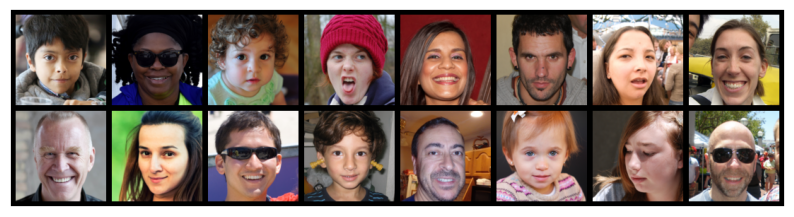

In [ ]:
# plot some training images
show_batch(train_dl)

**Часть 2. Построение и обучение модели (2 балла)**

Сконструируйте генератор и дискриминатор. Помните, что:
* дискриминатор принимает на вход изображение (тензор размера `3 x image_size x image_size`) и выдает вероятность того, что изображение настоящее (тензор размера 1)

* генератор принимает на вход тензор шумов размера `latent_size x 1 x 1` и генерирует изображение размера `3 x image_size x image_size`

In [ ]:
# taken from the official pytorch tutorial:
# https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
# custom weights initialization
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Number of channels in the training images.
# For color images this is 3 (red, green, blue)
number_channels = 3

# Size of feature maps in discriminator
disc_fm_size = 32

In [ ]:
discriminator = nn.Sequential(
    # input is `number_channels x image_size x image_size`
    # input is `number_channels x 128 x 128`
    nn.Conv2d(in_channels=number_channels, out_channels=disc_fm_size, kernel_size=4, stride=2, padding=1, bias=False),
    nn.LeakyReLU(0.2, inplace=True),
    # out:  disc_fm_size x 64 x 64

    # state size `disc_fm_size x 64 x 64`
    nn.Conv2d(disc_fm_size, disc_fm_size * 2, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(disc_fm_size * 2),
    nn.LeakyReLU(0.2, inplace=True),
    # out:  disc_fm_size* 2 x 32 x 32

    # state size. `(disc_fm_size*2) x 32 x 32`
    nn.Conv2d(disc_fm_size * 2, disc_fm_size * 4, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(disc_fm_size * 4),
    nn.LeakyReLU(0.2, inplace=True),

    # state size. `(disc_fm_size*4) x 16 x 16`
    nn.Conv2d(disc_fm_size * 4, disc_fm_size * 8, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(disc_fm_size * 8),
    nn.LeakyReLU(0.2, inplace=True),

    # state size. `(disc_fm_size*8) x 8 x 8`
    nn.Conv2d(disc_fm_size * 8, disc_fm_size * 16, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(disc_fm_size * 16),
    nn.LeakyReLU(0.2, inplace=True),

    # state size. `(disc_fm_size*16) x 4 x 4`
    nn.Conv2d(disc_fm_size * 16, 1, kernel_size=4, stride=1, padding=0, bias=False),


    nn.Flatten(),# Flattens a contiguous range of dims into a tensor.
    nn.Sigmoid() # activation function - sigmoid function
)

In [ ]:
# Create the Discriminator
discriminator = to_device(discriminator, device)

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
discriminator.apply(weights_init)

print(discriminator)

Sequential(
  (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (1): LeakyReLU(negative_slope=0.2, inplace=True)
  (2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (4): LeakyReLU(negative_slope=0.2, inplace=True)
  (5): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): LeakyReLU(negative_slope=0.2, inplace=True)
  (8): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (10): LeakyReLU(negative_slope=0.2, inplace=True)
  (11): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (12): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

In [ ]:
# Size of feature maps in generator
gen_fm_size = 64

latent_size = 128 # latent size

In [ ]:
generator = nn.Sequential(
    nn.ConvTranspose2d(latent_size, gen_fm_size*16, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(gen_fm_size*16),
    nn.ReLU(True),

    #nn.ConvTranspose2d(latent_size, gen_fm_size*8, kernel_size=4, stride=1, padding=0, bias=False),
    nn.ConvTranspose2d(gen_fm_size*16, gen_fm_size*8, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(gen_fm_size*8),
    nn.ReLU(True),

    nn.ConvTranspose2d(gen_fm_size*8, gen_fm_size*4, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(gen_fm_size*4),
    nn.ReLU(True),

    nn.ConvTranspose2d(gen_fm_size*4, gen_fm_size*2, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(gen_fm_size*2),
    nn.ReLU(True),

    nn.ConvTranspose2d(gen_fm_size*2, gen_fm_size, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(gen_fm_size),
    nn.ReLU(True),

    nn.ConvTranspose2d(gen_fm_size, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh() # applies the hyperbolic tangent function
)

In [ ]:
generator.to(device)

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
generator.apply(weights_init)

# Print the model
print(generator)

Sequential(
  (0): ConvTranspose2d(128, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (5): ReLU(inplace=True)
  (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (8): ReLU(inplace=True)
  (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): ReLU(inplace=True)
  (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (13): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, t

Перейдем теперь к обучению нашего GANа. Алгоритм обучения следующий:
1. Учим дискриминатор:
  * берем реальные изображения и присваиваем им метку 1
  * генерируем изображения генератором и присваиваем им метку 0
  * обучаем классификатор на два класса

2. Учим генератор:
  * генерируем изображения генератором и присваиваем им метку 0
  * предсказываем дискриминаторором, реальное это изображение или нет


В качестве функции потерь берем бинарную кросс-энтропию

In [ ]:
model = {
    "discriminator": discriminator,
    "generator": generator
}

In [ ]:
def fit(model, criterion, epochs, optimizer, start_idx=1):
    model["discriminator"].train()
    model["generator"].train()
    torch.cuda.empty_cache()

    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []

    for epoch in range(epochs):
        loss_d_per_epoch = []
        loss_g_per_epoch = []
        real_score_per_epoch = []
        fake_score_per_epoch = []
        for real_images, _ in tqdm(train_dl):
            # Train discriminator
            # Clear discriminator gradients
            optimizer["discriminator"].zero_grad()

            # Pass real images through discriminator
            real_preds = model["discriminator"](real_images)
            real_targets = torch.ones(real_images.size(0), 1, device=device)
            real_loss = criterion["discriminator"](real_preds, real_targets)
            cur_real_score = torch.mean(real_preds).item()

            # Generate fake images
            latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
            fake_images = model["generator"](latent)

            # Pass fake images through discriminator
            fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
            fake_preds = model["discriminator"](fake_images)
            fake_loss = criterion["discriminator"](fake_preds, fake_targets)
            cur_fake_score = torch.mean(fake_preds).item()

            real_score_per_epoch.append(cur_real_score)
            fake_score_per_epoch.append(cur_fake_score)

            # Update discriminator weights
            loss_d = real_loss + fake_loss
            loss_d.backward()
            optimizer["discriminator"].step()
            loss_d_per_epoch.append(loss_d.item())


            # Train generator
            # Clear generator gradients
            optimizer["generator"].zero_grad()

            # Generate fake images
            latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
            fake_images = model["generator"](latent)

            # Try to fool the discriminator
            preds = model["discriminator"](fake_images)
            targets = torch.ones(batch_size, 1, device=device)
            loss_g = criterion["generator"](preds, targets)

            # Update generator weights
            loss_g.backward()
            optimizer["generator"].step()
            loss_g_per_epoch.append(loss_g.item())

        # Record losses & scores
        losses_g.append(np.mean(loss_g_per_epoch))
        losses_d.append(np.mean(loss_d_per_epoch))
        real_scores.append(np.mean(real_score_per_epoch))
        fake_scores.append(np.mean(fake_score_per_epoch))

        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs,
            losses_g[-1], losses_d[-1], real_scores[-1], fake_scores[-1]))

        # Generation example
        plt.figure(figsize=(14,14))
        plt.axis("off")
        plt.title("Generated images")
        plt.imshow(np.transpose(make_grid(fake_images.to(device)[:16], padding=2, normalize=True).cpu(),(1,2,0)))
        plt.show()

    return losses_g, losses_d, real_scores, fake_scores

In [ ]:
# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of training epochs
num_epochs = 50

criterion = {
    "discriminator": nn.BCELoss(),
    "generator": nn.BCELoss(),
}

optimizer = {
    #"discriminator": torch.optim.SGD(discriminator.parameters(), lr=0.01, momentum=0.5),
    #"discriminator": torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999)),
    "discriminator": torch.optim.RMSprop(discriminator.parameters(), lr=lr),
    "generator": torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))
}

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [1/50], loss_g: 11.9678, loss_d: 1.3450, real_score: 0.8195, fake_score: 0.2120


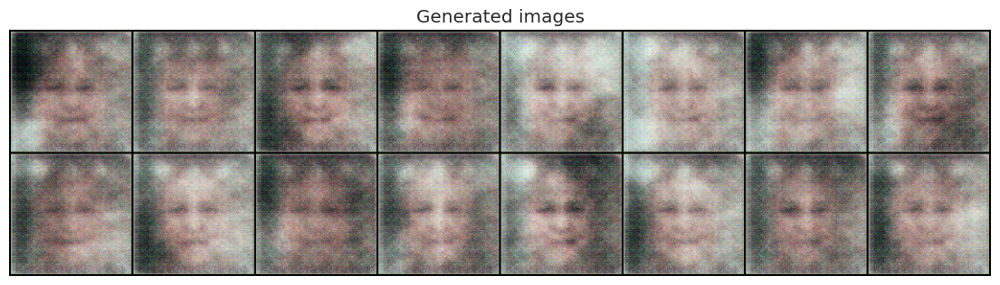

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [2/50], loss_g: 2.9882, loss_d: 1.0562, real_score: 0.7203, fake_score: 0.2708


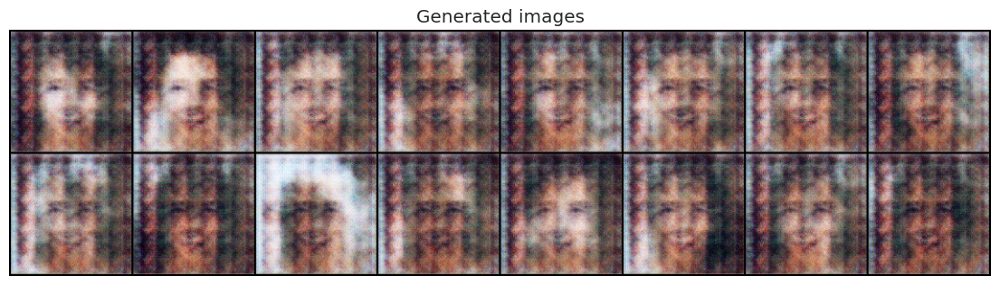

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [3/50], loss_g: 3.7241, loss_d: 0.8048, real_score: 0.7803, fake_score: 0.2157


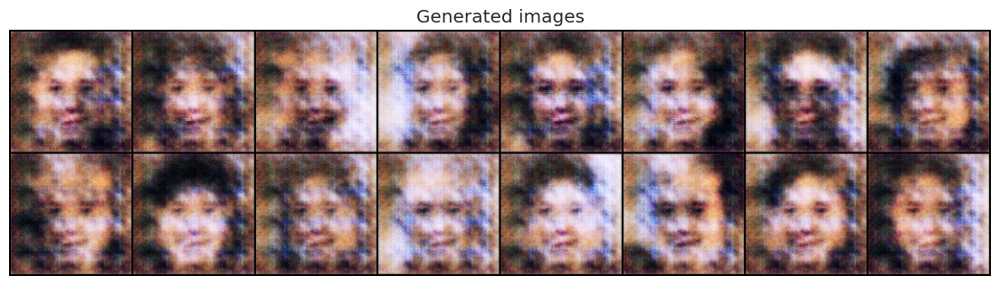

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [4/50], loss_g: 3.4002, loss_d: 0.8758, real_score: 0.7597, fake_score: 0.2439


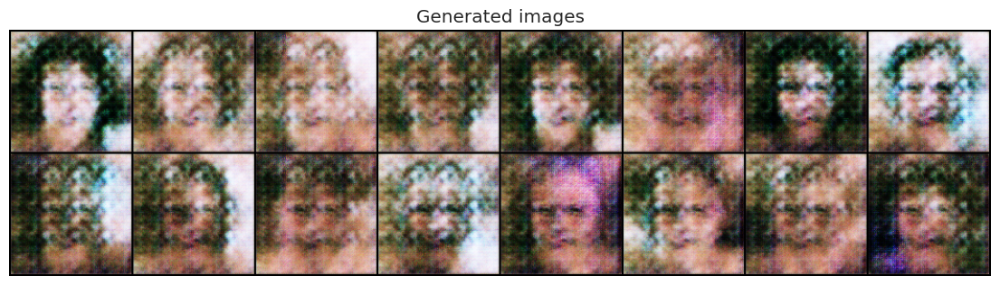

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [5/50], loss_g: 3.3821, loss_d: 0.9404, real_score: 0.7409, fake_score: 0.2617


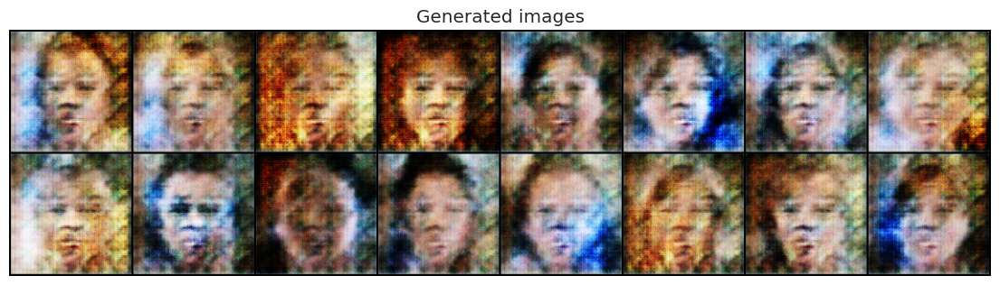

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [6/50], loss_g: 2.9768, loss_d: 0.9820, real_score: 0.7135, fake_score: 0.2852


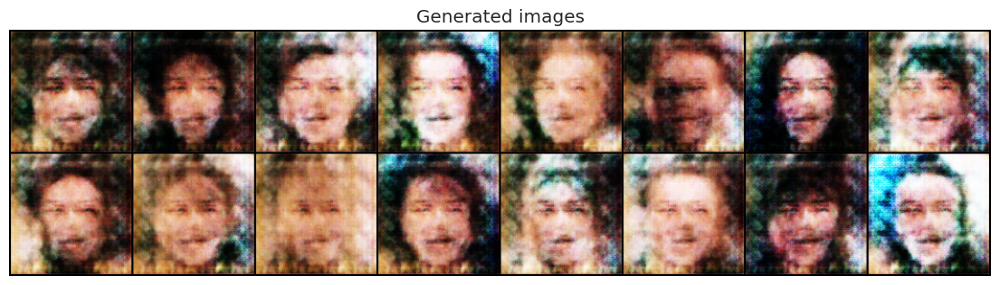

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [7/50], loss_g: 2.9741, loss_d: 1.0470, real_score: 0.6919, fake_score: 0.3006


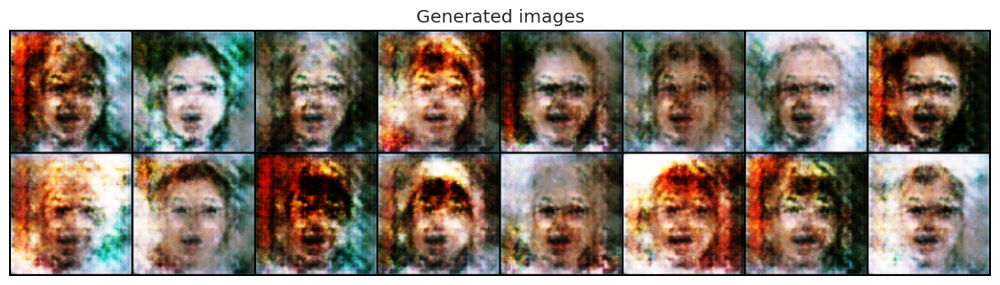

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [8/50], loss_g: 2.7902, loss_d: 0.9757, real_score: 0.6950, fake_score: 0.3025


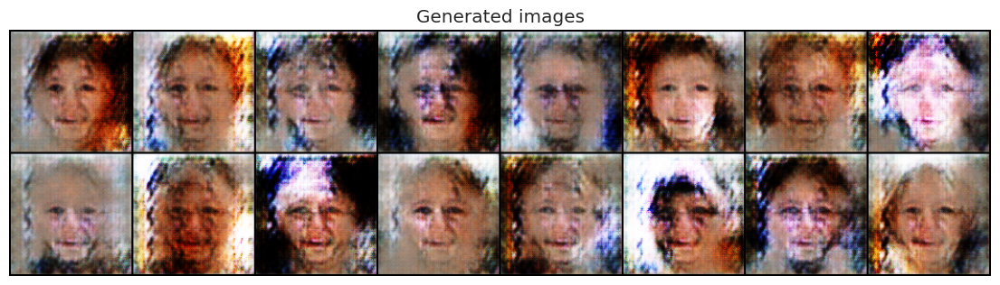

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [9/50], loss_g: 3.2813, loss_d: 0.9496, real_score: 0.7079, fake_score: 0.2815


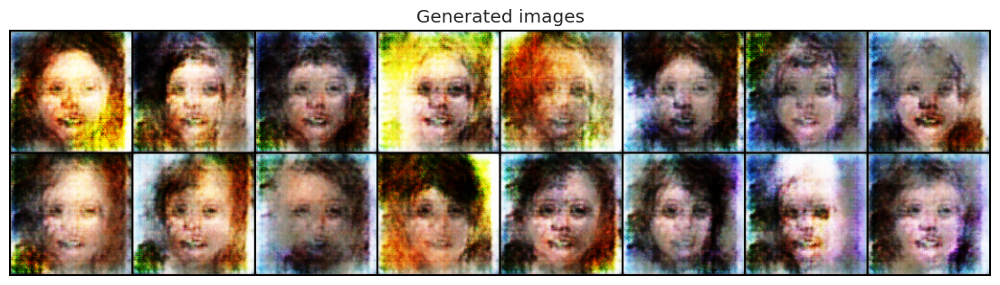

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [10/50], loss_g: 3.0690, loss_d: 0.9275, real_score: 0.7138, fake_score: 0.2857


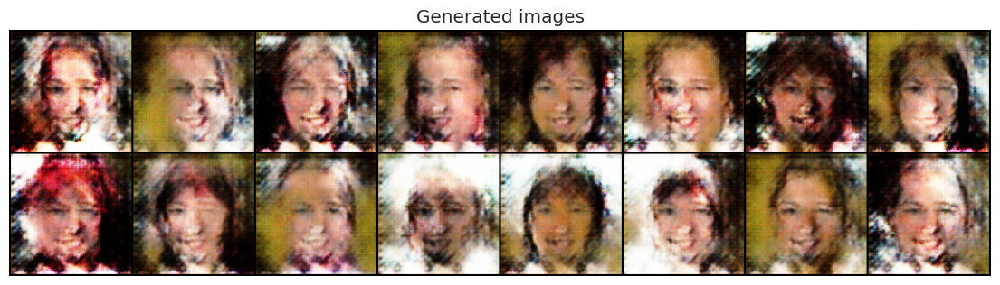

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [11/50], loss_g: 3.4262, loss_d: 0.8956, real_score: 0.7264, fake_score: 0.2719


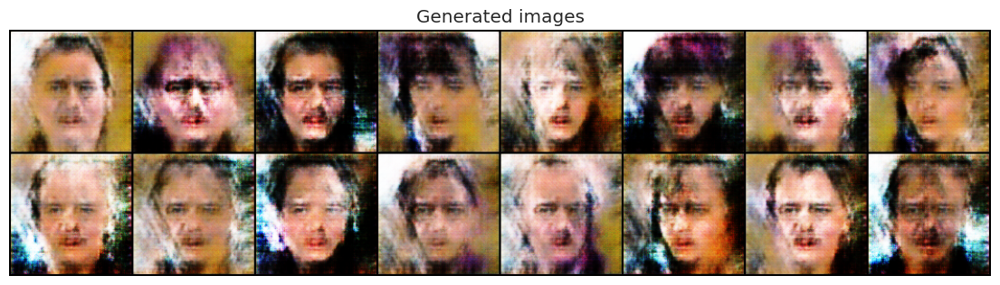

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [12/50], loss_g: 3.3649, loss_d: 0.8840, real_score: 0.7262, fake_score: 0.2677


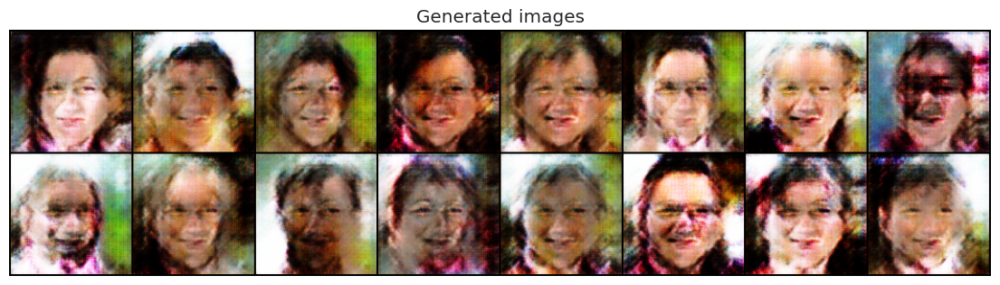

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [13/50], loss_g: 3.3280, loss_d: 0.8787, real_score: 0.7311, fake_score: 0.2680


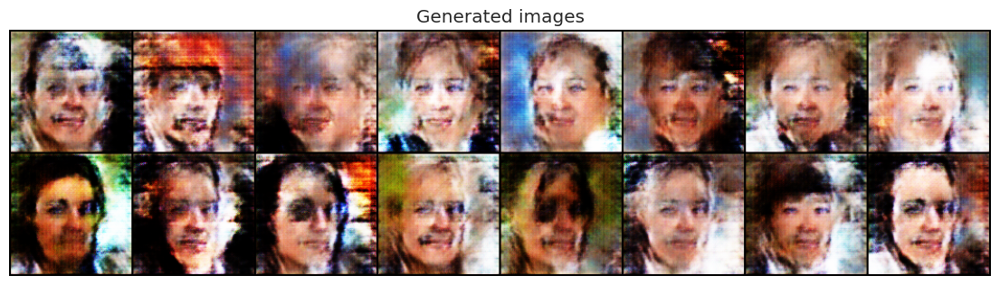

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [14/50], loss_g: 3.2268, loss_d: 0.9067, real_score: 0.7204, fake_score: 0.2758


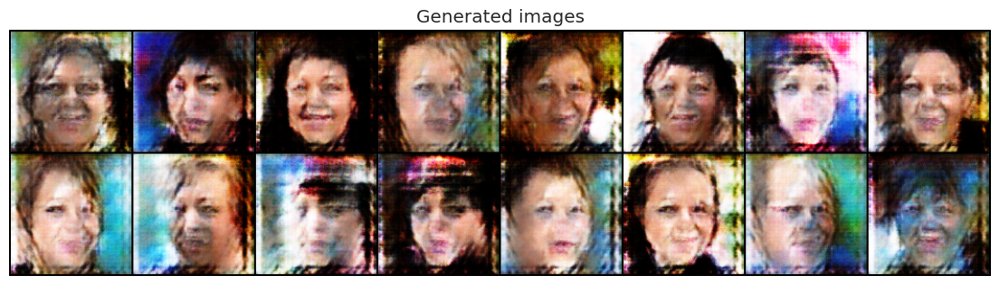

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [15/50], loss_g: 3.1081, loss_d: 0.9115, real_score: 0.7193, fake_score: 0.2790


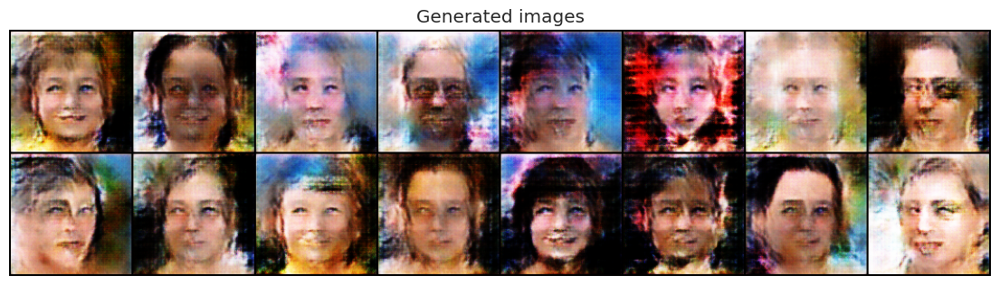

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [16/50], loss_g: 3.0193, loss_d: 0.8662, real_score: 0.7278, fake_score: 0.2719


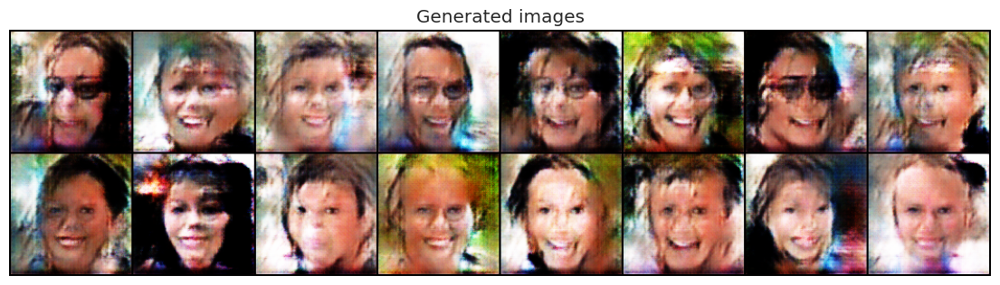

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [17/50], loss_g: 3.0111, loss_d: 0.9043, real_score: 0.7213, fake_score: 0.2769


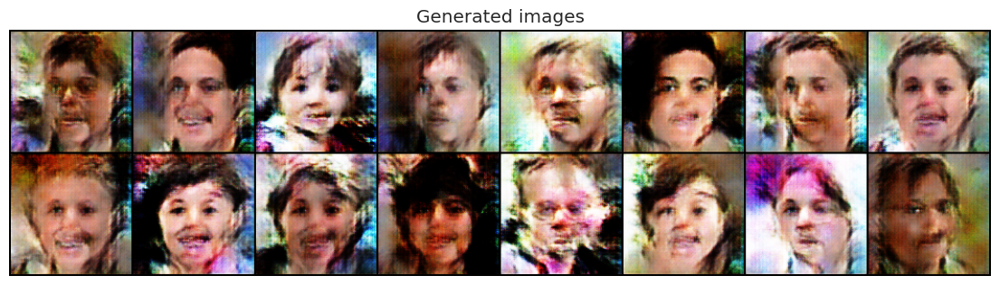

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [18/50], loss_g: 2.8916, loss_d: 0.8874, real_score: 0.7186, fake_score: 0.2753


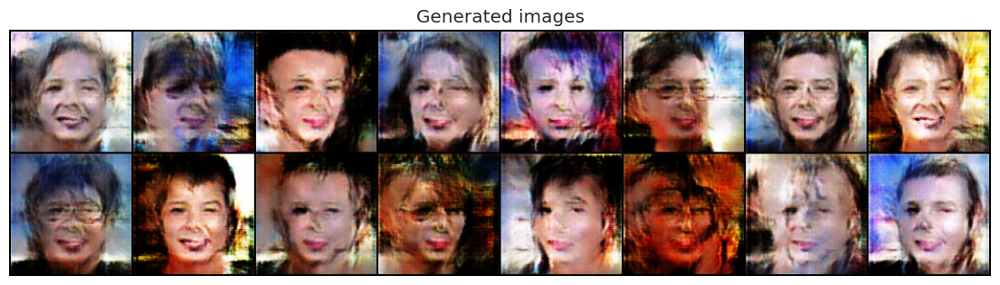

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [19/50], loss_g: 2.9870, loss_d: 0.8666, real_score: 0.7287, fake_score: 0.2688


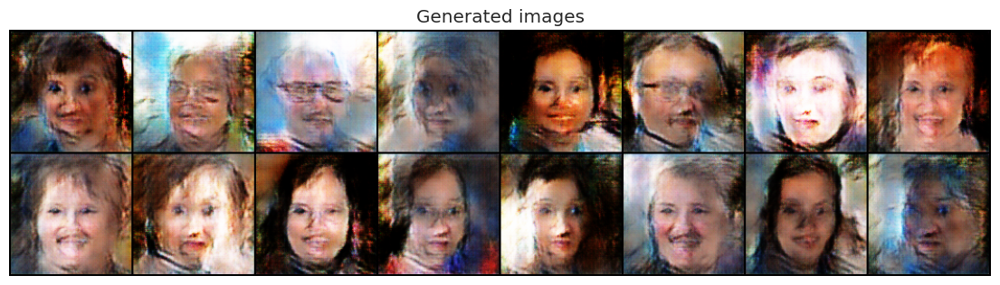

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [20/50], loss_g: 2.9777, loss_d: 0.8136, real_score: 0.7387, fake_score: 0.2601


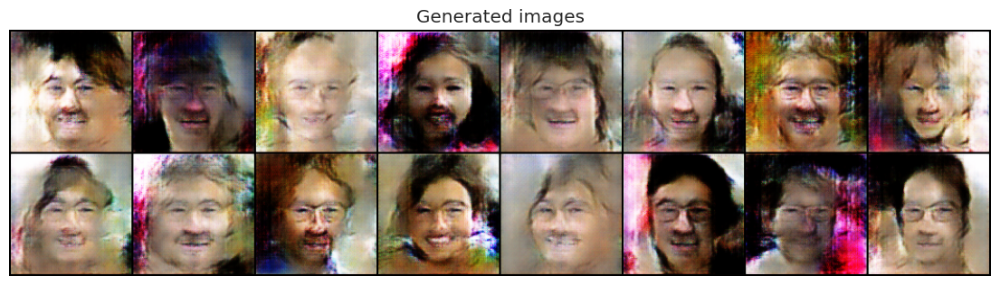

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [21/50], loss_g: 2.8951, loss_d: 0.8508, real_score: 0.7328, fake_score: 0.2682


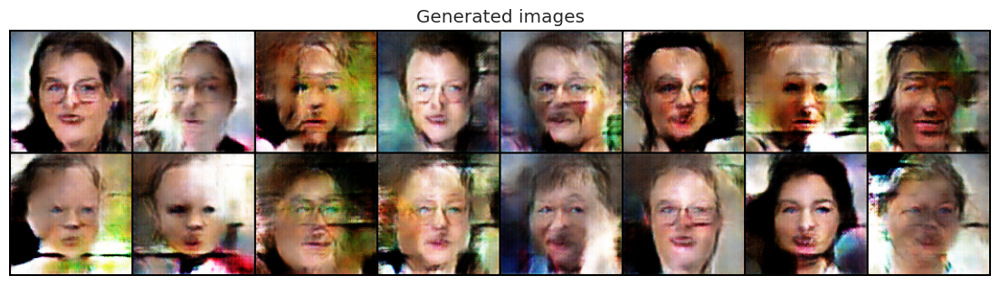

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [22/50], loss_g: 2.7625, loss_d: 0.8184, real_score: 0.7353, fake_score: 0.2607


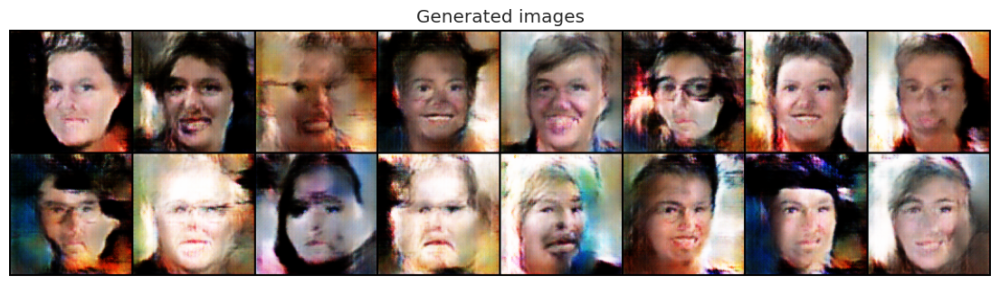

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [23/50], loss_g: 2.7572, loss_d: 0.8625, real_score: 0.7334, fake_score: 0.2660


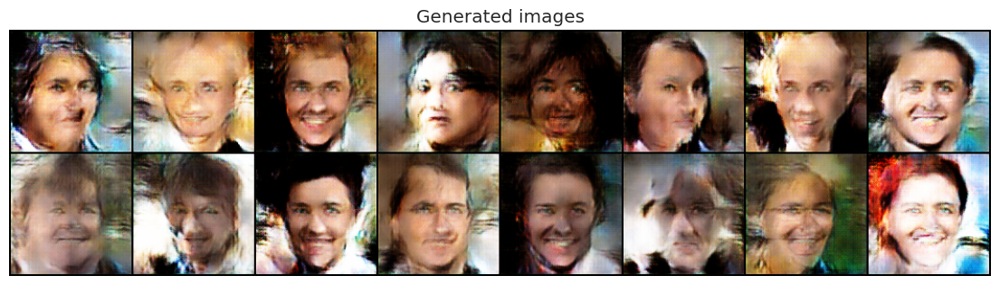

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [24/50], loss_g: 2.7369, loss_d: 0.8031, real_score: 0.7388, fake_score: 0.2583


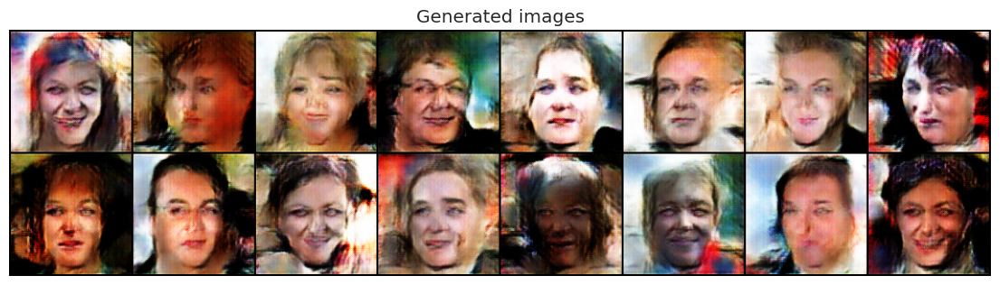

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [25/50], loss_g: 2.7861, loss_d: 0.7977, real_score: 0.7434, fake_score: 0.2551


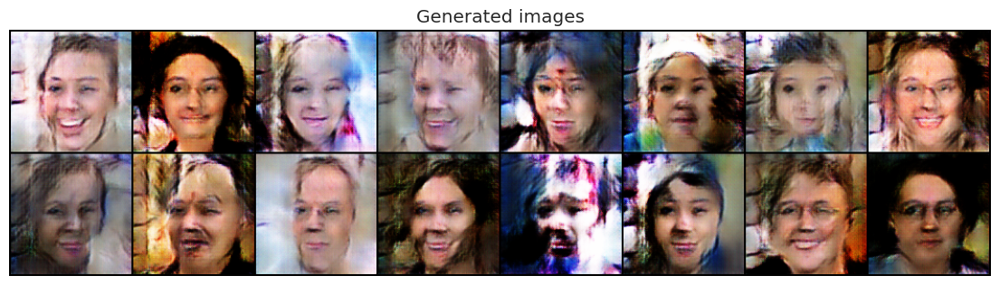

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [26/50], loss_g: 2.7906, loss_d: 0.8175, real_score: 0.7415, fake_score: 0.2577


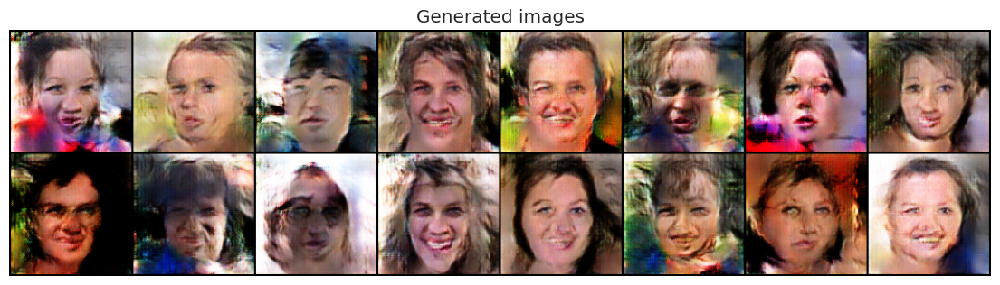

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [27/50], loss_g: 2.7608, loss_d: 0.7847, real_score: 0.7430, fake_score: 0.2551


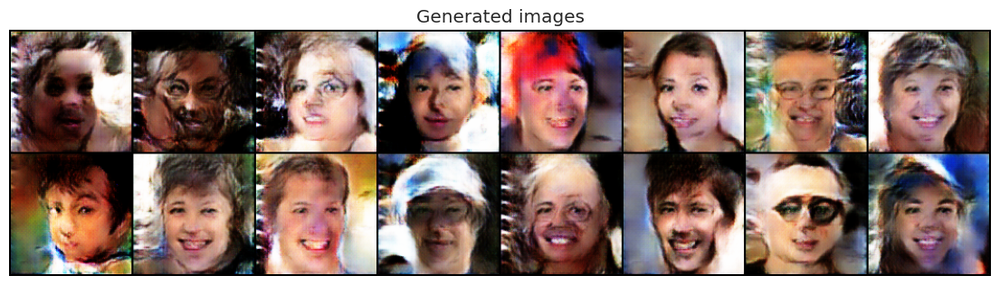

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [28/50], loss_g: 2.7243, loss_d: 0.7636, real_score: 0.7518, fake_score: 0.2483


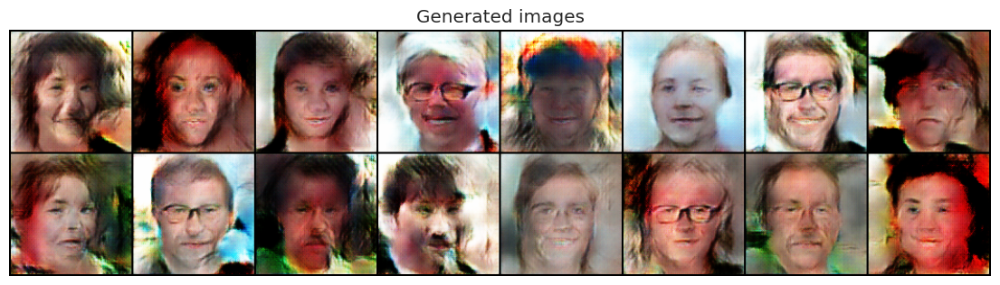

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [29/50], loss_g: 2.7929, loss_d: 0.7848, real_score: 0.7526, fake_score: 0.2469


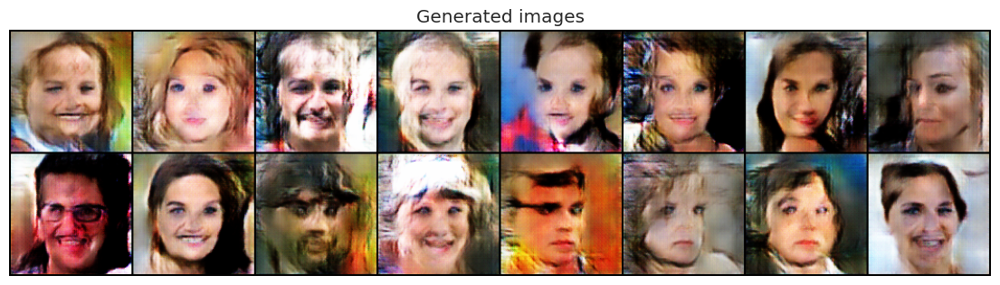

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [30/50], loss_g: 2.8733, loss_d: 0.7577, real_score: 0.7583, fake_score: 0.2403


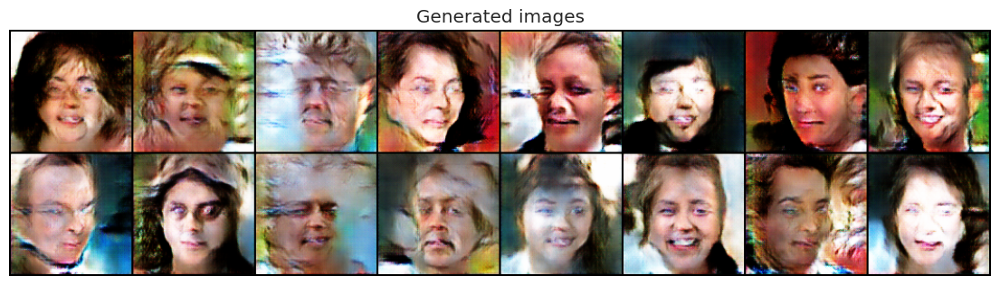

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [31/50], loss_g: 2.8303, loss_d: 0.6938, real_score: 0.7683, fake_score: 0.2275


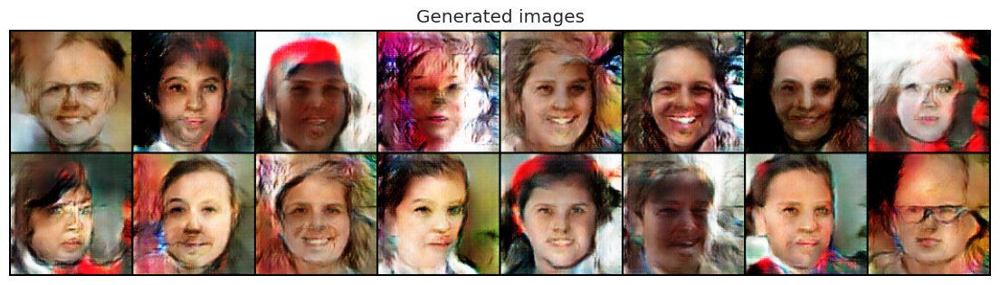

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [32/50], loss_g: 2.8415, loss_d: 0.7149, real_score: 0.7668, fake_score: 0.2352


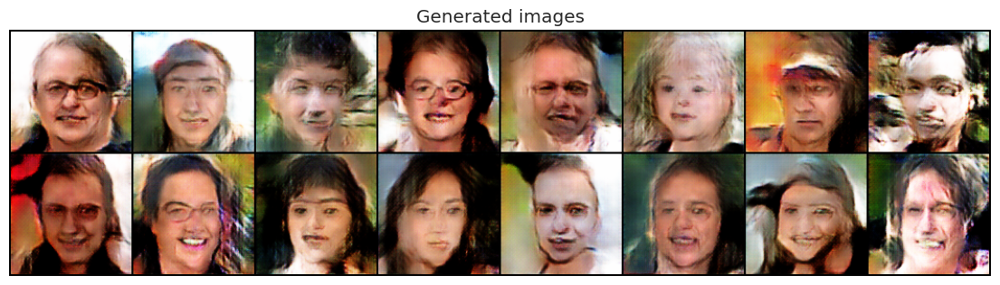

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [33/50], loss_g: 2.8584, loss_d: 0.7268, real_score: 0.7682, fake_score: 0.2328


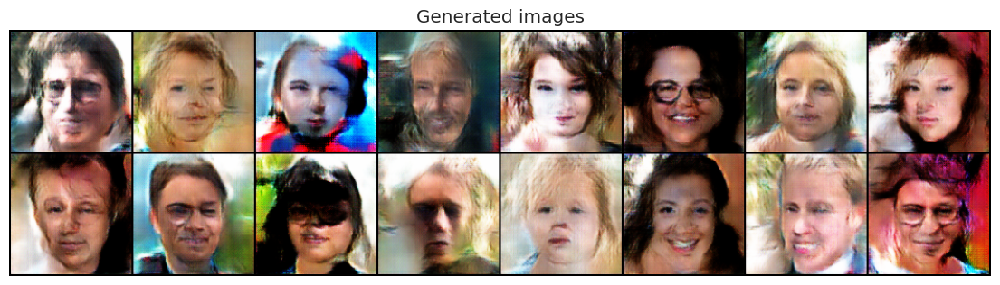

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [34/50], loss_g: 2.8841, loss_d: 0.6866, real_score: 0.7761, fake_score: 0.2227


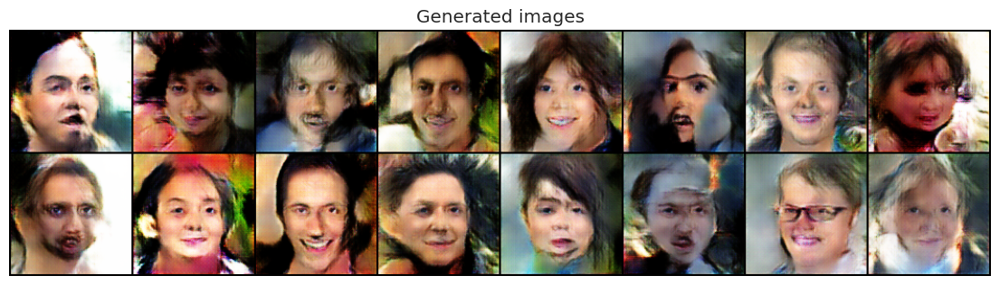

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [35/50], loss_g: 2.9044, loss_d: 0.6487, real_score: 0.7862, fake_score: 0.2124


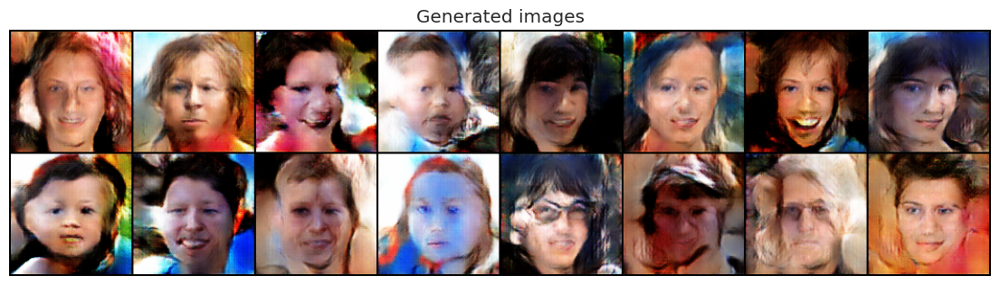

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [36/50], loss_g: 2.9605, loss_d: 0.6924, real_score: 0.7807, fake_score: 0.2181


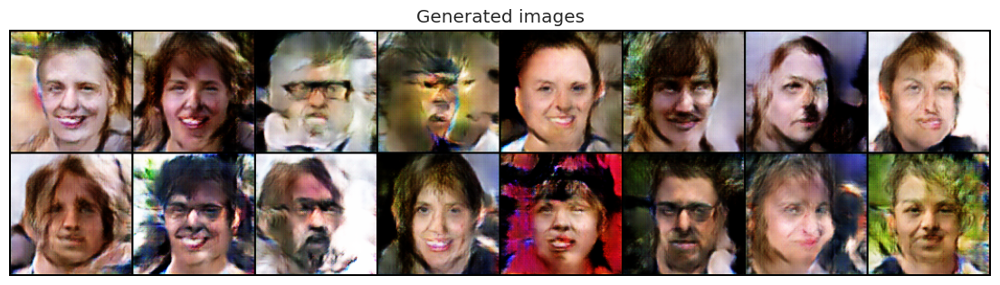

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [37/50], loss_g: 3.0063, loss_d: 0.6477, real_score: 0.7880, fake_score: 0.2109


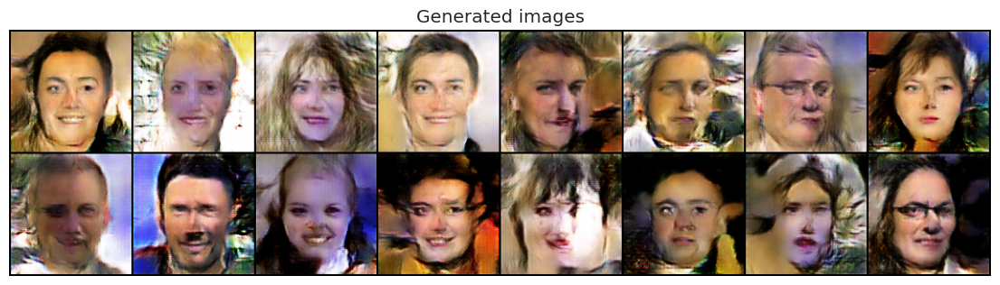

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [38/50], loss_g: 3.0115, loss_d: 0.6026, real_score: 0.8015, fake_score: 0.2005


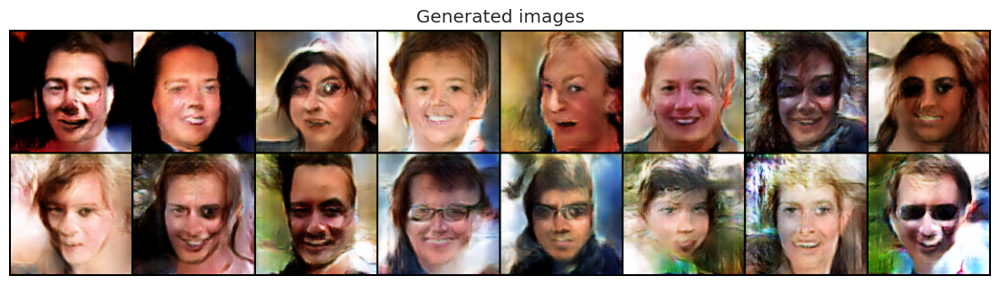

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [39/50], loss_g: 3.1067, loss_d: 0.6271, real_score: 0.7939, fake_score: 0.2048


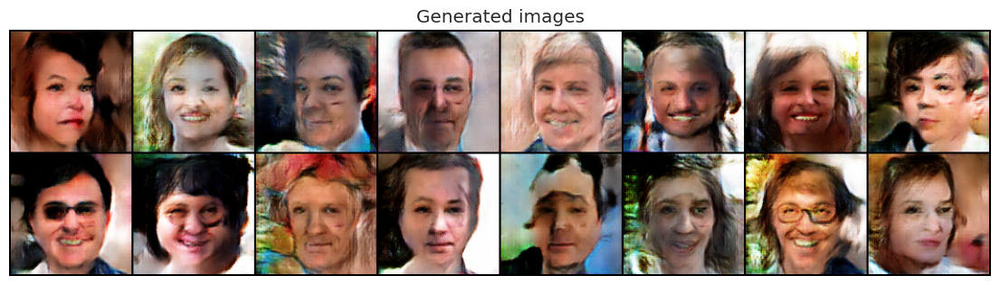

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [40/50], loss_g: 3.1225, loss_d: 0.5998, real_score: 0.8035, fake_score: 0.1947


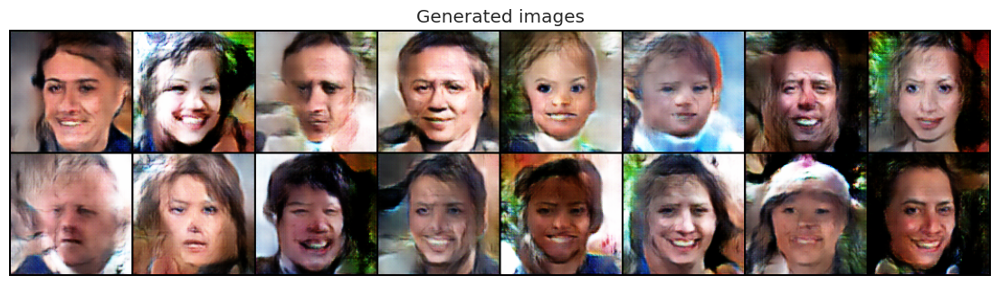

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [41/50], loss_g: 3.0649, loss_d: 0.6125, real_score: 0.8065, fake_score: 0.1940


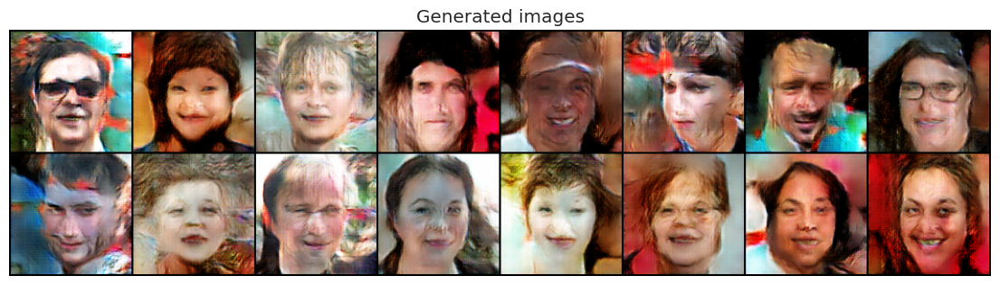

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [42/50], loss_g: 3.1966, loss_d: 0.5552, real_score: 0.8125, fake_score: 0.1867


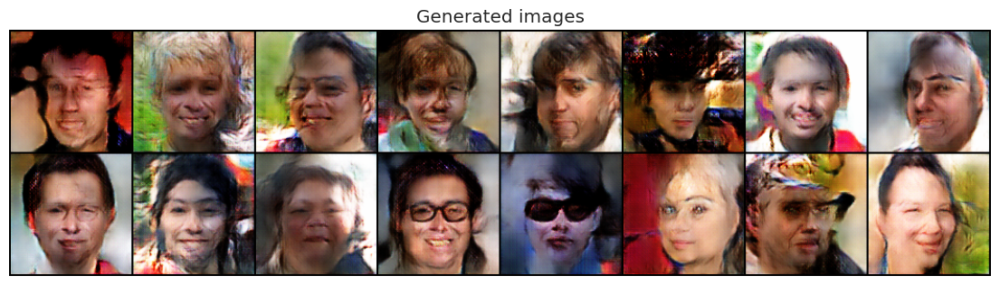

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [43/50], loss_g: 3.1569, loss_d: 0.5348, real_score: 0.8165, fake_score: 0.1817


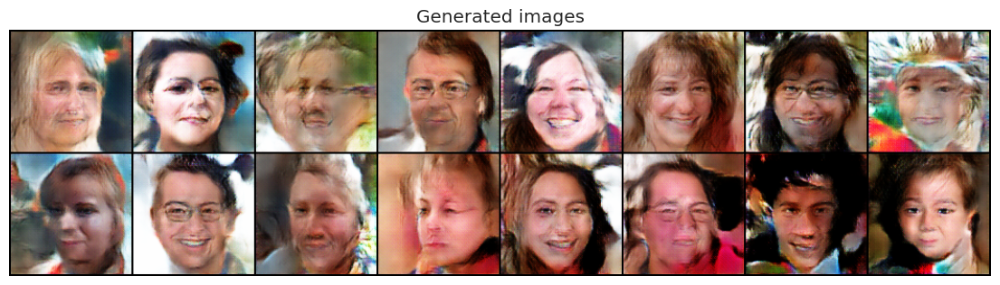

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [44/50], loss_g: 3.2548, loss_d: 0.5671, real_score: 0.8152, fake_score: 0.1846


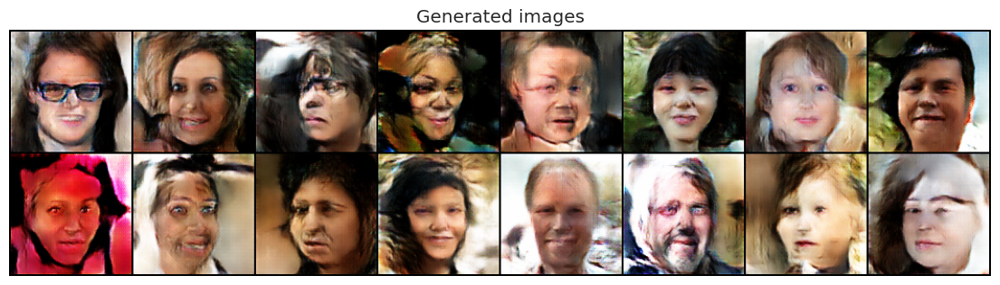

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [45/50], loss_g: 3.2886, loss_d: 0.5535, real_score: 0.8210, fake_score: 0.1803


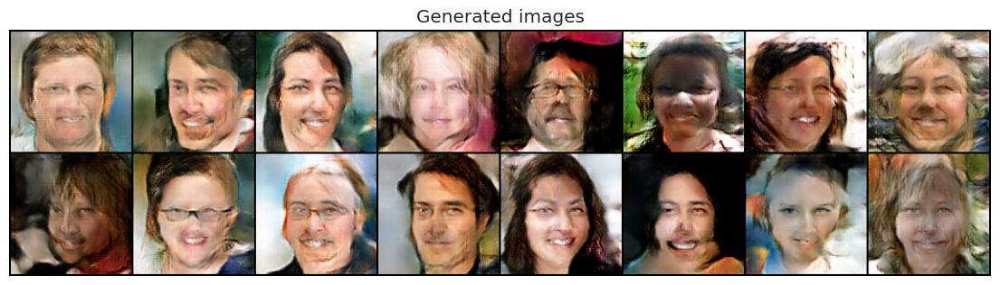

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [46/50], loss_g: 3.3777, loss_d: 0.5174, real_score: 0.8279, fake_score: 0.1718


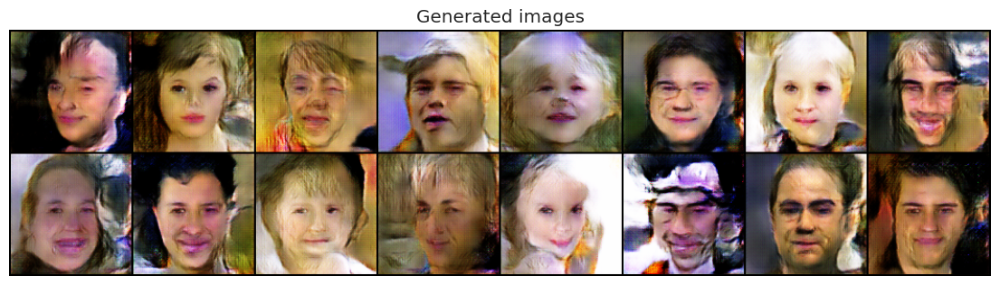

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [47/50], loss_g: 3.3584, loss_d: 0.4897, real_score: 0.8327, fake_score: 0.1661


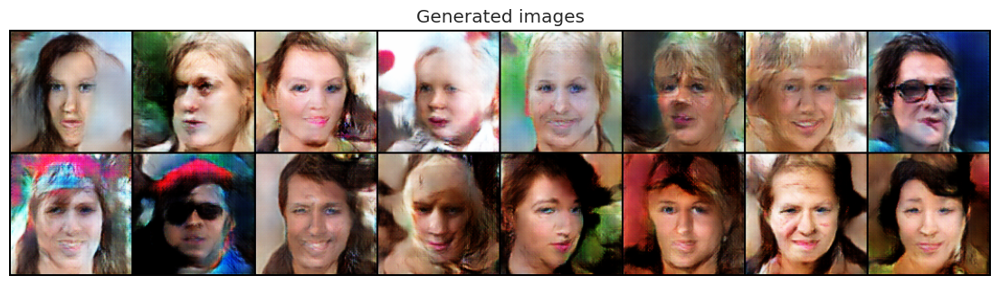

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [48/50], loss_g: 3.4700, loss_d: 0.5428, real_score: 0.8265, fake_score: 0.1737


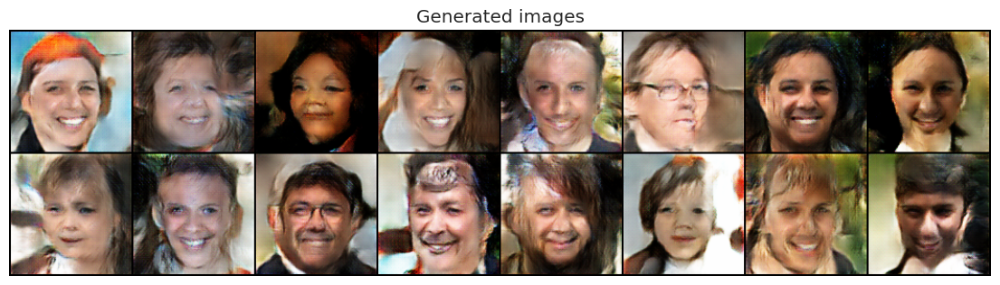

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [49/50], loss_g: 3.4471, loss_d: 0.5045, real_score: 0.8399, fake_score: 0.1593


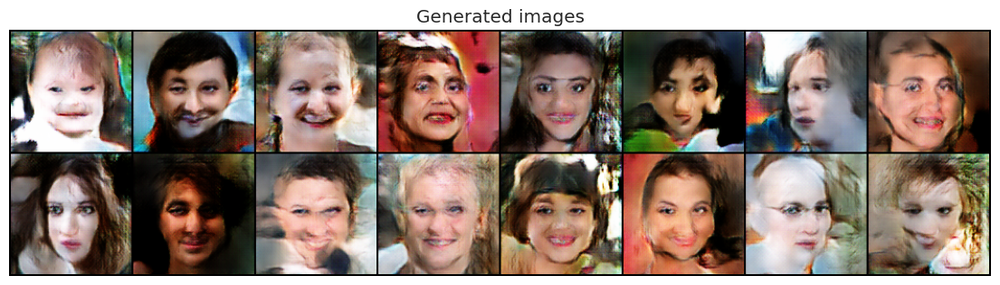

  0%|          | 0/197 [00:00<?, ?it/s]

Epoch [50/50], loss_g: 3.5016, loss_d: 0.4864, real_score: 0.8387, fake_score: 0.1613


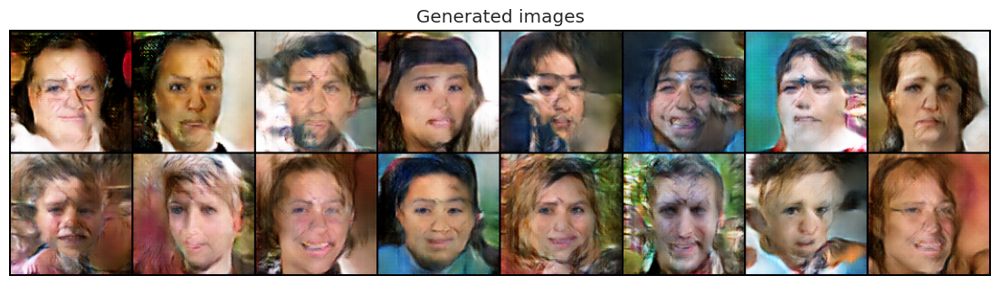

In [ ]:
history = fit(model, criterion, num_epochs, optimizer)

In [ ]:
losses_g, losses_d, real_scores, fake_scores = history

Постройте графики лосса для генератора и дискриминатора. Что вы можете сказать про эти графики?

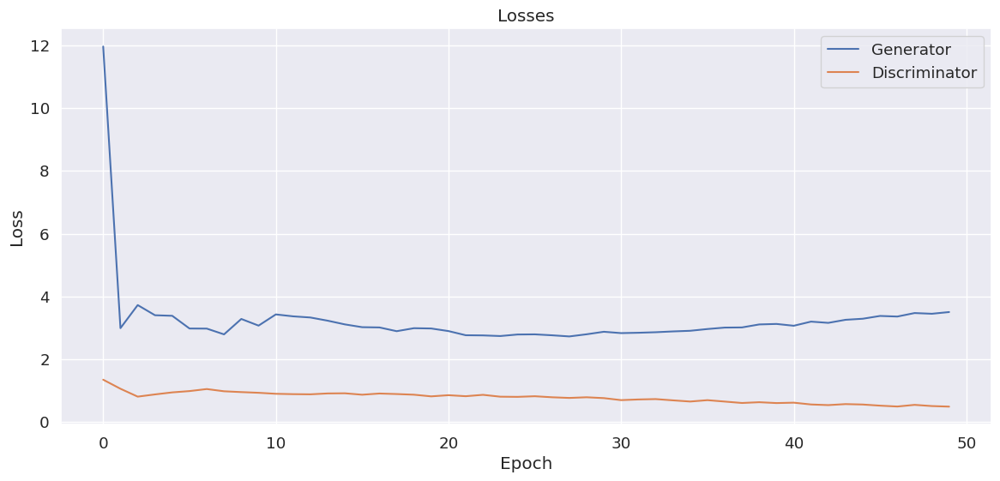

In [ ]:
plt.figure(figsize=(14, 6))
plt.title("Losses")
plt.plot(losses_g, label="Generator")
plt.plot(losses_d, label="Discriminator")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.show()

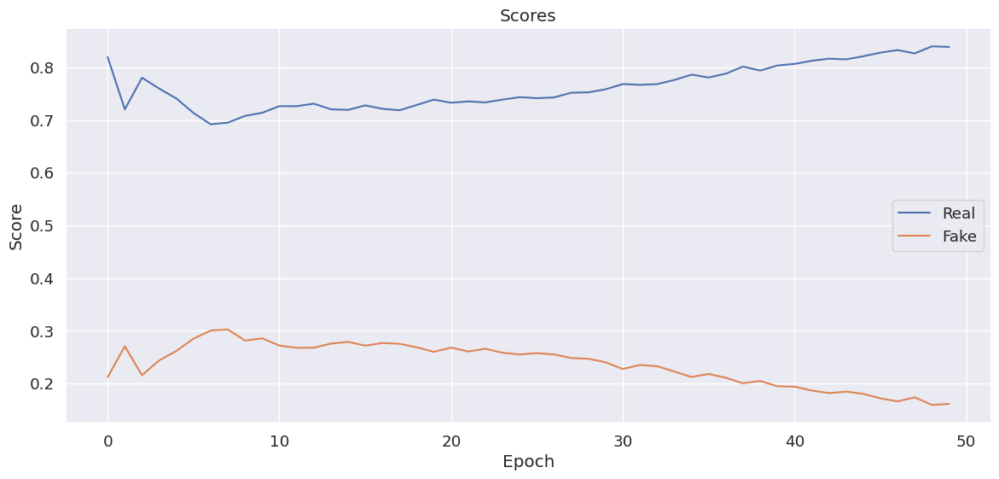

In [ ]:
plt.figure(figsize=(14, 6))
plt.title("Scores")
plt.plot(real_scores, label="Real")
plt.plot(fake_scores, label="Fake")
plt.xlabel("Epoch")
plt.ylabel("Score")
plt.legend()
plt.show()

Поведение графиков  в целом примерно такое же, как было показано на лекции, семинаре.

**Часть 3. Генерация изображений (1 балл)**

Теперь давайте оценим качество получившихся изображений. Напишите функцию, которая выводит изображения, сгенерированные нашим генератором

In [ ]:
n_images = 32

fixed_latent = torch.randn(n_images, latent_size, 1, 1, device=device)
fake_images = model["generator"](fixed_latent)

In [ ]:
def show_images(generated):
    plt.figure(figsize=(14, 14))
    plt.axis("off")
    plt.title("Generated images")
    plt.imshow(np.transpose(make_grid(generated.to(device), padding=2, normalize=True).cpu(),(1,2,0)))

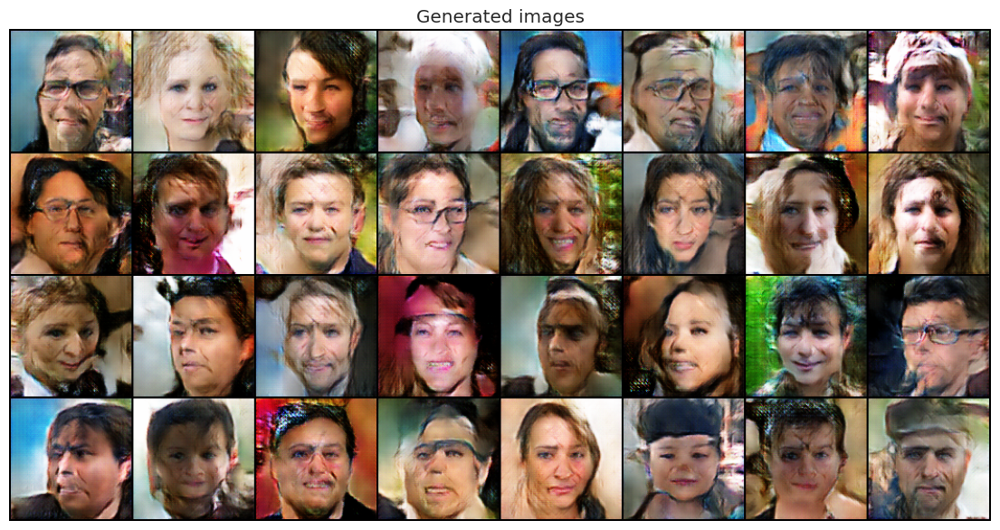

In [ ]:
show_images(fake_images)

Как вам качество получившихся изображений?

Качество изображений "оставляет желать лучшего", много артефактов. Но на изображениях ясно видны  черты человеческого лица.   
Контур лица, глаза, волосы, губы, нос, уши, шея, лоб и т.д.  У лиц разный цвет кожи, возраст, пол, у некоторых  
есть очки.   В процессе обучения с увеличением количества эпох сгенерированные изображения все больше становяться похожи на лица людей.  
Что говорит о том, что модели способны эффективно обучаться.   
Изменение архитектуры моделей, оптимизаторов и др. не привели к значительному  улучшению  качества картинок.   
Вероятно, чтобы улучшить качество  нужно использовать датасет с большим количеством картинок.

**Часть 4. Leave-one-out-1-NN classifier accuracy (6 баллов)**

**4.1. Подсчет accuracy (4 балла)**

Не всегда бывает удобно оценивать качество сгенерированных картинок глазами.   
В качестве альтернативы вам предлагается реализовать следующий подход:
  * Сгенерировать столько же фейковых изображений, сколько есть настоящих в обучающей выборке.   
  Присвоить фейковым метку класса 0, настоящим – 1.
  * Построить leave-one-out оценку: обучить 1NN Classifier   
  (`sklearn.neighbors.KNeighborsClassifier(n_neighbors=1)`)   
  предсказывать класс на всех объектах, кроме одного, проверить качество (accuracy) на оставшемся объекте.   
  В этом вам поможет `sklearn.model_selection.LeaveOneOut`

In [ ]:
n_images = 3143

fixed_latent = torch.randn(n_images, latent_size, 1, 1, device=device)

model["generator"].eval()
with torch.no_grad():
    fake_images = model["generator"].to(device)(fixed_latent)

real_images = []
for id in tqdm(range(n_images)):
    real_images.append(train_ds[id][0])

  0%|          | 0/3143 [00:00<?, ?it/s]

In [ ]:
# reshape images
new_fake_images = fake_images.reshape(fake_images.shape[0], -1)
new_real_images = torch.stack(real_images).reshape(fake_images.shape[0], -1)

In [ ]:
X = torch.concat([new_fake_images.cpu(), new_real_images.cpu()]).numpy()
y = torch.concat((torch.ones(n_images), torch.zeros(n_images))).numpy()

In [ ]:
kn_classif = KNeighborsClassifier(n_neighbors=1)
scores = cross_val_score(kn_classif, X, y, cv=LeaveOneOut())
print(f"Leave-One-Out score: {scores.mean()}")

Leave-One-Out score: 0.7578746420617245


Что вы можете сказать о получившемся результате? Какой accuracy мы хотели бы получить и почему?

Результат не идеальный, accuracy=0.757 далека от значения 0.5. Мы хотели бы получить accuracy = 0.5, это означало бы, что классификатор не может отличить  
настоящую картинку от сгенерированной.

**4.2. Визуализация распределений (2 балла)**

Давайте посмотрим на то, насколько похожи распределения настоящих и фейковых изображений.    
Для этого воспользуйтесь методом, снижающим размерность (к примеру, TSNE) и изобразите на графике   
разным цветом точки, соответствующие реальным и сгенерированным изображенияи

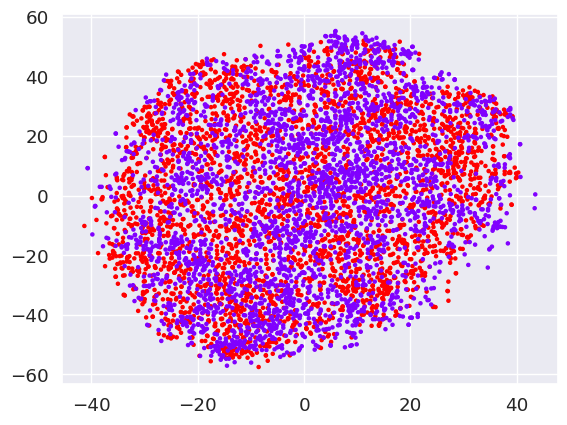

In [ ]:
# t-distributed stochastic neighbor embedding
embed = TSNE(n_components=2)
X_embed = embed.fit_transform(X)

# print('New Shape of X: ', X_embed.shape)

x1, x2 = zip(*X_embed)
plt.scatter(x1, x2, c=y, s=5, cmap='rainbow')

Прокомментируйте получившийся результат:

Распределения сгенерированных и настоящих изображений похожи. Но точки распеределены не равномерно,   
есть области где точек одного цвета значительно больше чем другого.  
Если построить данный график после обучения на малом количестве эпох, то можно увидеть, что точки распределены еще менее равномерно   
(Точки одного цвета лежат более кучно, больше областей со скоплениями точек одного цвета). Что может  свидетельствовать о   
правильном направлении обучения модели.